# Compare Models

DS 5001 Text as Data

# Set Up

## Config

In [1]:
import configparser
config = configparser.ConfigParser()
config.read("../../../env.ini")
data_home = config['DEFAULT']['data_home']
output_dir = config['DEFAULT']['output_dir']
local_lib = config['DEFAULT']['local_lib']

In [2]:
data_prefix = "winereviews"

## Import

In [3]:
import pandas as pd
import numpy as np
import plotly_express as px

# Results

In [5]:
models = 'NB SKMNB MI PERCEPTRON SVM LOGREG'.split()
results = {model: pd.read_csv(f'{data_home}/{data_prefix}/{data_prefix}-{model}_RESULT.csv').set_index('model_id') for model in models}
RESULT = pd.concat([results[model] for model in models], axis=0)

In [6]:
RESULT

,TN,FN,TP,FP,T,F,ALL,ACC,TPR,TNR,PPV,BA,F1
model_id,,,,,,,,,,,,,
nb,3084,694,3277,945,6361,1639,8000,0.795125,0.825233,0.765450,0.776172,0.795342,0.799951
skmnb,3252,877,3152,719,6404,1596,8000,0.800500,0.782328,0.818937,0.814260,0.800633,0.797975
mi,1928,598,3373,2101,5301,2699,8000,0.662625,0.849408,0.478531,0.616186,0.663969,0.714240
perceptron,3434,1194,2777,595,6211,1789,8000,0.776375,0.699320,0.852321,0.823547,0.775820,0.756367
svm,3290,839,3132,739,6422,1578,8000,0.802750,0.788718,0.816580,0.809093,0.802649,0.798776
logreg,3367,720,3251,662,6618,1382,8000,0.827250,0.818685,0.835691,0.830820,0.827188,0.824708


In [7]:
RESULT1 = RESULT.iloc[:, :7]

In [8]:
RESULT1.style.background_gradient(cmap='YlGnBu') # COUNTS

,TN,FN,TP,FP,T,F,ALL
model_id,,,,,,,
nb,3084,694,3277,945,6361,1639,8000
skmnb,3252,877,3152,719,6404,1596,8000
mi,1928,598,3373,2101,5301,2699,8000
perceptron,3434,1194,2777,595,6211,1789,8000
svm,3290,839,3132,739,6422,1578,8000
logreg,3367,720,3251,662,6618,1382,8000


In [9]:
RESULT2 = RESULT.iloc[:,7:] # RATIOS

In [10]:
ratio_names = {
    'ACC':'accuracy',
    'TPR': 'recall',
    'TNR': 'specificity',
    'PPV': 'precision',
    'BA': 'balacc',
    'F1': 'F1'
}

In [11]:
RESULT2.columns = [ratio_names[col] for col in RESULT2.columns]

In [12]:
RESULT2.sort_values('F1', ascending=False).style.format(precision=2).background_gradient(cmap='YlGnBu', axis=None)

,accuracy,recall,specificity,precision,balacc,F1
model_id,,,,,,
logreg,0.83,0.82,0.84,0.83,0.83,0.82
nb,0.80,0.83,0.77,0.78,0.80,0.80
svm,0.80,0.79,0.82,0.81,0.80,0.80
skmnb,0.80,0.78,0.82,0.81,0.80,0.80
perceptron,0.78,0.70,0.85,0.82,0.78,0.76
mi,0.66,0.85,0.48,0.62,0.66,0.71


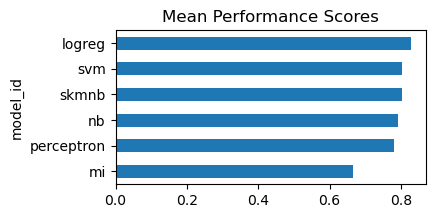

In [13]:
RESULT2.T.mean().sort_values().plot.barh(figsize=(4,2), title="Mean Performance Scores");

In [14]:
METRIC = pd.concat([RESULT2.idxmax(), RESULT2.max(), RESULT2.idxmin(), RESULT2.min()], axis=1, 
                   keys=['argmax','max','argmin','min'])

In [15]:
METRIC.style.format(precision=2)

,argmax,max,argmin,min
accuracy,logreg,0.83,mi,0.66
recall,mi,0.85,perceptron,0.70
specificity,perceptron,0.85,mi,0.48
precision,logreg,0.83,mi,0.62
balacc,logreg,0.83,mi,0.66
F1,logreg,0.82,mi,0.71


**Winners**

In [16]:
METRIC.argmax.value_counts()

argmax
logreg        4
mi            1
perceptron    1
Name: count, dtype: int64

**Losers**

In [17]:
METRIC.argmin.value_counts()

argmin
mi            5
perceptron    1
Name: count, dtype: int64

# SALEXes

In [18]:
salex_cols = ['valence', 'polarity', 'normalized']

In [19]:
salexes = {model : pd.read_csv(f'{data_home}/{data_prefix}/{data_prefix}-{model}_SALEX.csv').set_index('term_str')
         for model in models}

In [20]:
SALEX = pd.concat([salexes[model][salex_cols] for model in models], keys=models, axis=1)

In [21]:
SALEX

NB                         SKMNB                      \
            valence polarity normalized   valence polarity normalized   
term_str                                                                
dilute    -9.315725     -1.0  -1.000000 -4.161267     -1.0  -0.915330   
watery    -9.164041     -1.0  -0.983822 -4.058082     -1.0  -0.891859   
raspy     -8.958083     -1.0  -0.961855 -3.918320     -1.0  -0.860069   
weedy     -8.481484     -1.0  -0.911022 -3.596737     -1.0  -0.786921   
fuss      -8.259947     -1.0  -0.887394 -3.448317     -1.0  -0.753161   
...             ...      ...        ...       ...      ...        ...   
chaparral  7.787368      1.0   0.824168  3.137855      1.0   0.744938   
exquisite  8.263967      1.0   0.875001  3.459439      1.0   0.818086   
94         8.758851      1.0   0.927784  3.795911      1.0   0.894621   
2027       9.186272      1.0   0.973371  4.088047      1.0   0.961070   
92         9.435940      1.0   1.000000  4.259195      1.0   1.000000   

                 MI                     PERCEPTRON                      \
            valence polarity normalized    valence polarity normalized   
term_str                                                                 
dilute    -9.317604     -1.0  -1.000000      -27.0     -1.0  -0.401709   
watery    -9.165921     -1.0  -0.983822      -12.0     -1.0  -0.145299   
raspy     -8.959962     -1.0  -0.961855      -32.0     -1.0  -0.487179   
weedy     -8.483364     -1.0  -0.911022      -23.0     -1.0  -0.333333   
fuss      -8.261827     -1.0  -0.887394      -24.0     -1.0  -0.350427   
...             ...      ...        ...        ...      ...        ...   
chaparral  7.785489      1.0   0.824168       21.0      1.0   0.418803   
exquisite  8.262087      1.0   0.875001       36.0      1.0   0.675214   
94         8.756971      1.0   0.927784       25.0      1.0   0.487179   
2027       9.184392      1.0   0.973371       47.0      1.0   0.863248   
92         9.434061      1.0   1.000000       40.0      1.0   0.743590   

                SVM                        LOGREG                      
            valence polarity normalized   valence polarity normalized  
term_str                                                               
dilute    -1.062132     -1.0  -0.404986 -0.954047     -1.0  -0.577364  
watery    -0.570625     -1.0  -0.183480 -0.821235     -1.0  -0.527460  
raspy     -1.047760     -1.0  -0.398509 -1.352943     -1.0  -0.727250  
weedy     -1.013034     -1.0  -0.382859 -0.750820     -1.0  -0.501001  
fuss      -0.837652     -1.0  -0.303820 -1.086949     -1.0  -0.627302  
...             ...      ...        ...       ...      ...        ...  
chaparral  0.692016      1.0   0.385549  1.063527      1.0   0.180744  
exquisite  1.335239      1.0   0.675428  1.654371      1.0   0.402755  
94         0.931901      1.0   0.493657  1.199067      1.0   0.231673  
2027       1.558921      1.0   0.776234  2.071287      1.0   0.559412  
92         1.717667      1.0   0.847775  3.243837      1.0   1.000000  

[20772 rows x 18 columns]

In [22]:
NORM = SALEX.swaplevel(axis=1).normalized.dropna()

In [23]:
NORM

,NB,SKMNB,MI,PERCEPTRON,SVM,LOGREG
term_str,,,,,,
dilute,-1.000000,-0.915330,-1.000000,-0.401709,-0.404986,-0.577364
watery,-0.983822,-0.891859,-0.983822,-0.145299,-0.183480,-0.527460
raspy,-0.961855,-0.860069,-0.961855,-0.487179,-0.398509,-0.727250
weedy,-0.911022,-0.786921,-0.911022,-0.333333,-0.382859,-0.501001
fuss,-0.887394,-0.753161,-0.887394,-0.350427,-0.303820,-0.627302
...,...,...,...,...,...,...
chaparral,0.824168,0.744938,0.824168,0.418803,0.385549,0.180744
exquisite,0.875001,0.818086,0.875001,0.675214,0.675428,0.402755
94,0.927784,0.894621,0.927784,0.487179,0.493657,0.231673


In [24]:
VOCAB = pd.read_csv(f'{data_home}/{data_prefix}/{data_prefix}-VOCAB.csv').set_index('term_str')

In [25]:
VOCAB

,n,f,stem,sw,go
term_str,,,,,
aaron,4,0.000005,aaron,False,True
abandon,3,0.000004,abandon,False,True
abbey,3,0.000004,abbey,False,True
abbreviated,4,0.000005,abbrevi,False,True
ability,25,0.000033,abil,False,True
...,...,...,...,...,...
zippy,28,0.000036,zippi,False,True
zone,3,0.000004,zone,False,True
zweigelt,6,0.000008,zweigelt,False,True


# Compare Models 

Note differences between generative and discriminant models.

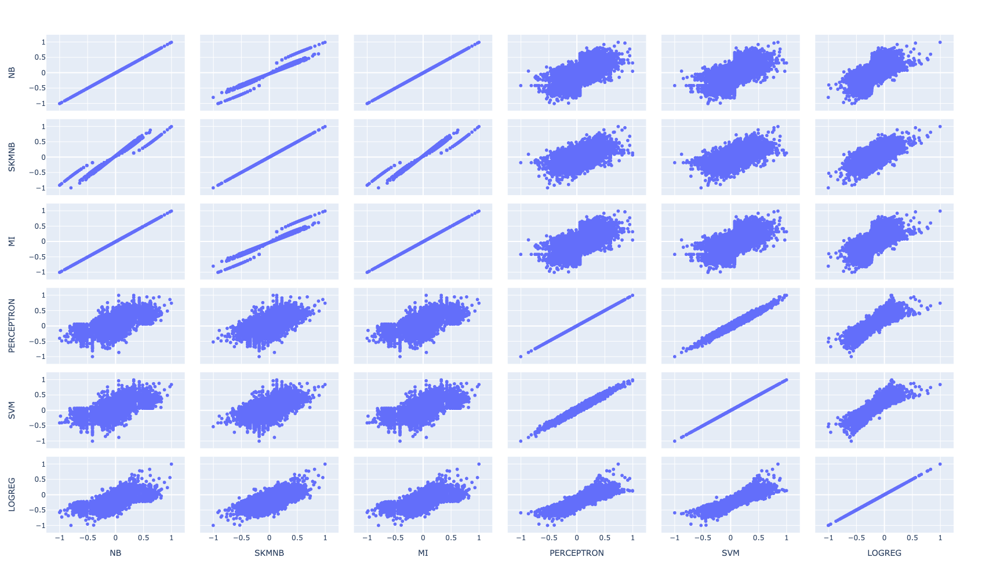

In [26]:
px.scatter_matrix(NORM, height=1000, width=1000)

In [26]:
CORR = NORM.corr().stack().to_frame('r')
CORR.index.names = ['model_1', 'model_2']
CORR = CORR.query("model_1 < model_2")

In [27]:
CORR.sort_values('r', ascending=False).style.format(precision=2).background_gradient(cmap="YlGnBu")

,,r
model_1,model_2,
MI,NB,1.00
PERCEPTRON,SVM,0.92
MI,SKMNB,0.87
NB,SKMNB,0.87
LOGREG,SVM,0.81
SKMNB,SVM,0.72
LOGREG,SKMNB,0.71
MI,SVM,0.62
NB,SVM,0.62


# Means of Normalized Valence

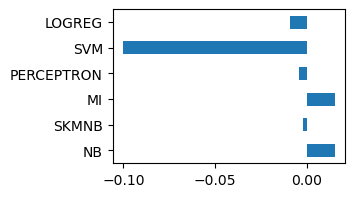

In [28]:
NORM.mean().plot.barh(figsize=(3,2));

# Mean Normalized Valence

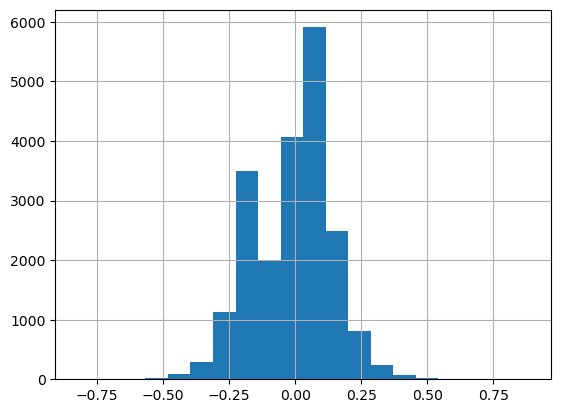

In [29]:
MEAN = NORM.T.mean()
MEAN.hist(bins=20);

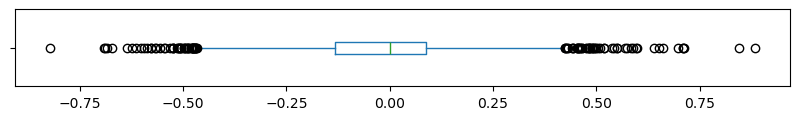

In [30]:
MEAN.plot.box(vert=False, figsize=(10, 1));

In [31]:
pd.concat([MEAN.sort_values(ascending=False).head(20).reset_index().rename(columns={0:'norm_valence'}), 
           MEAN.sort_values(ascending=False).tail(20).sort_values().reset_index().rename(columns={0:'norm_valence'})],
          axis=1, keys=['high', 'low'])

high                           low             
         term_str norm_valence         term_str norm_valence
0              92     0.883399           simple    -0.822301
1            2030     0.844533         everyday    -0.691967
2              91     0.711354            raspy    -0.688770
3            2027     0.711137         informal    -0.683946
4            2022     0.710903           dilute    -0.672924
5            2024     0.698495           watery    -0.634931
6     exceptional     0.660527            lacks    -0.623221
7            2028     0.652452          generic    -0.613503
8            2025     0.640106             dull    -0.601528
9        oakville     0.597895            pizza    -0.594578
10           2020     0.596262          diluted    -0.586732
11  extraordinary     0.589475            weedy    -0.578918
12       glorious     0.585054  straightforward    -0.577817
13     impressive     0.573794          vegetal    -0.568218
14           2021     0.570533          strange    -0.566257
15         superb     0.550888           sugary    -0.556470
16          sails     0.550640            catch    -0.545439
17       dazzling     0.543912         scouring    -0.542970
18       stunning     0.538879          gaseous    -0.531064
19           2026     0.518856      dimensional    -0.525679

# Scatter plots of term frequency

In [32]:
X = NORM.join(VOCAB)
X['mean'] = MEAN

In [33]:
def text(x):
    fig = px.scatter(X.reset_index(), x, 'n', text='term_str', height=800, width=900, title=x)
    fig.update_traces(mode="text")
    fig.show()

## Naive Bayes

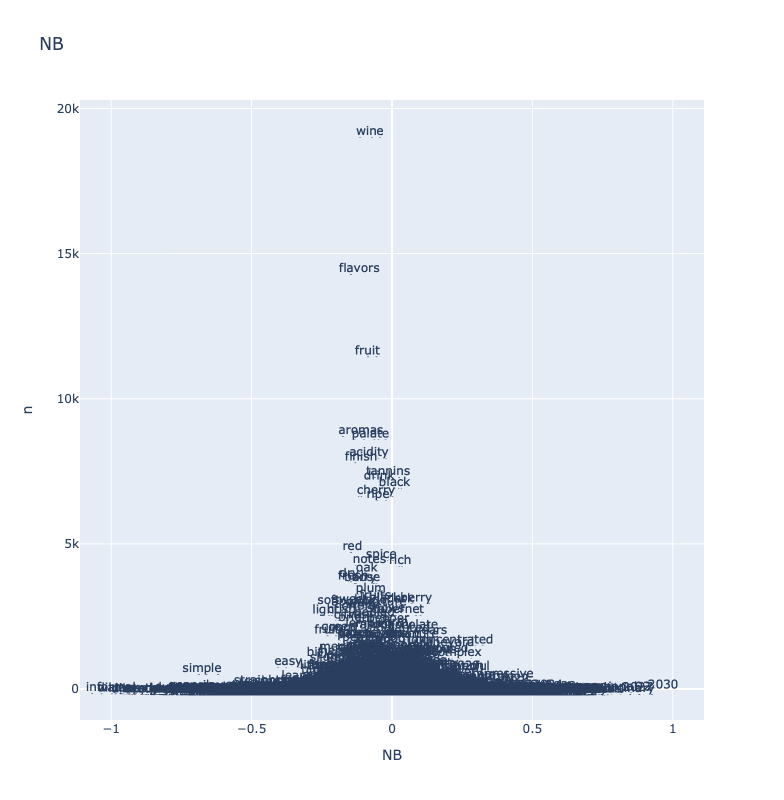

In [34]:
text('NB')

## SK Naive Bayes

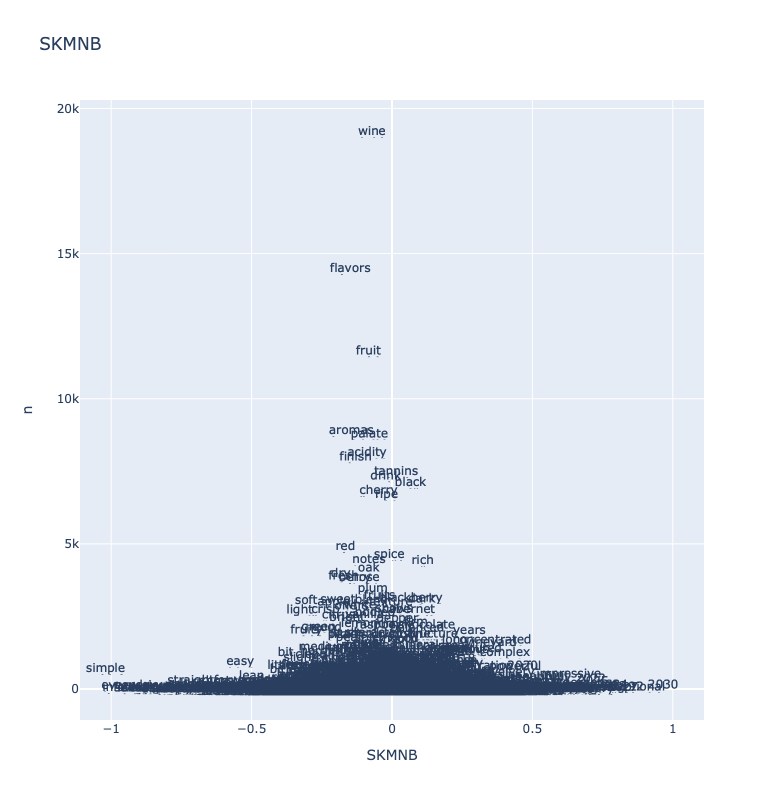

In [35]:
text('SKMNB')

## Perceptron

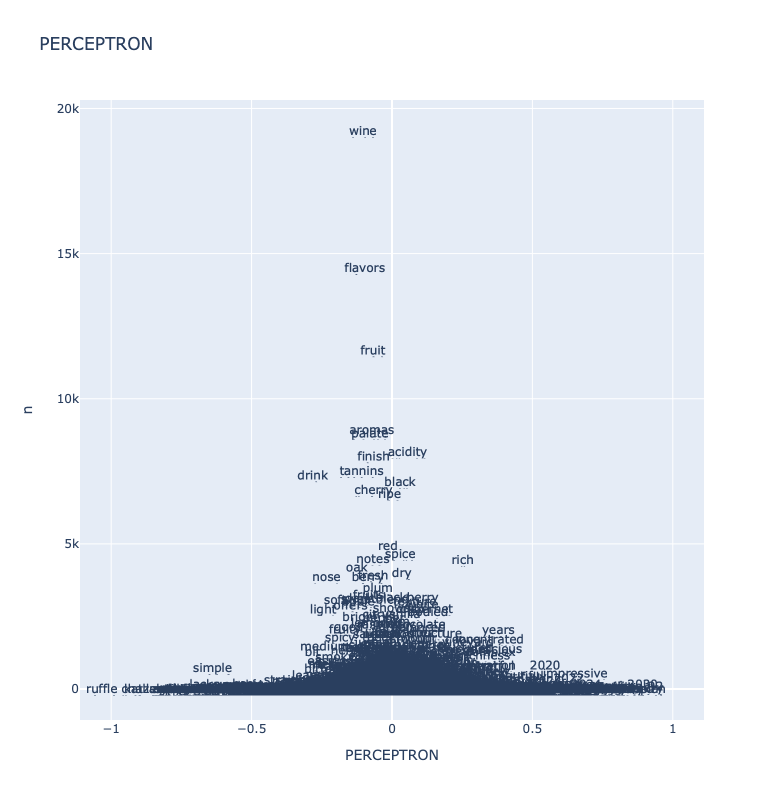

In [36]:
text('PERCEPTRON')

## EMI

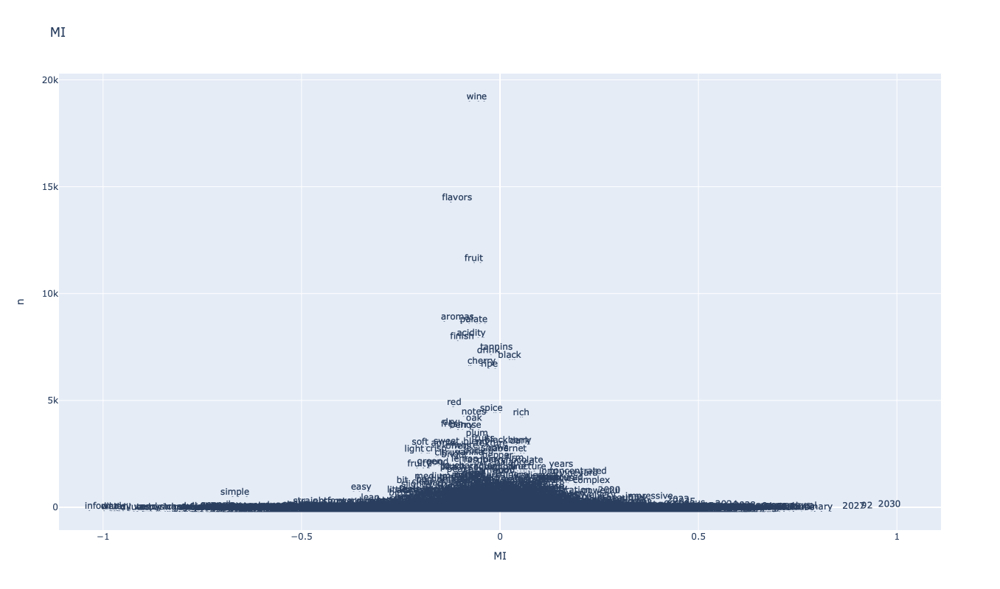

In [37]:
text('MI')

## SVM

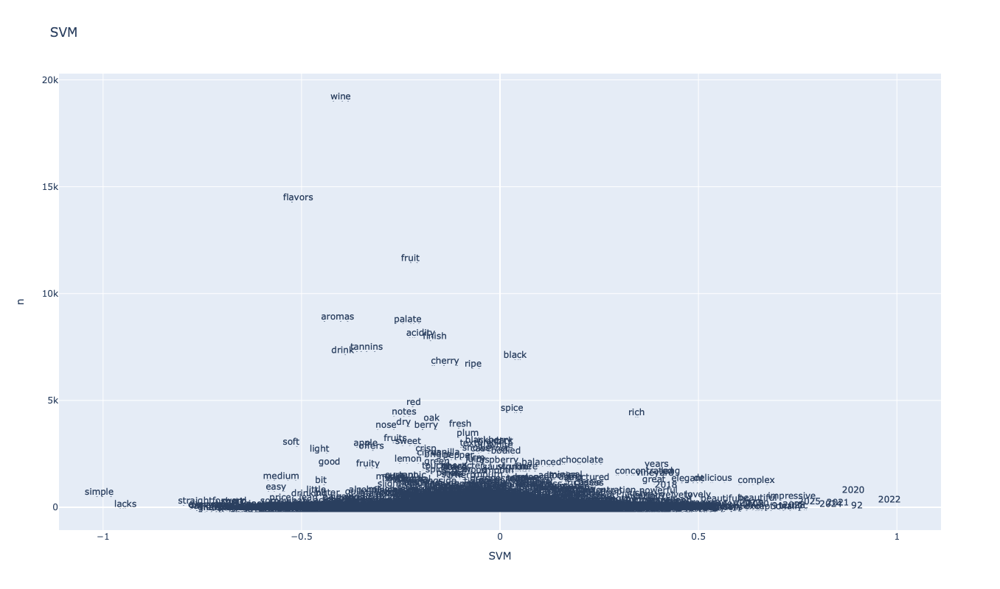

In [38]:
text('SVM')

## LOGREG

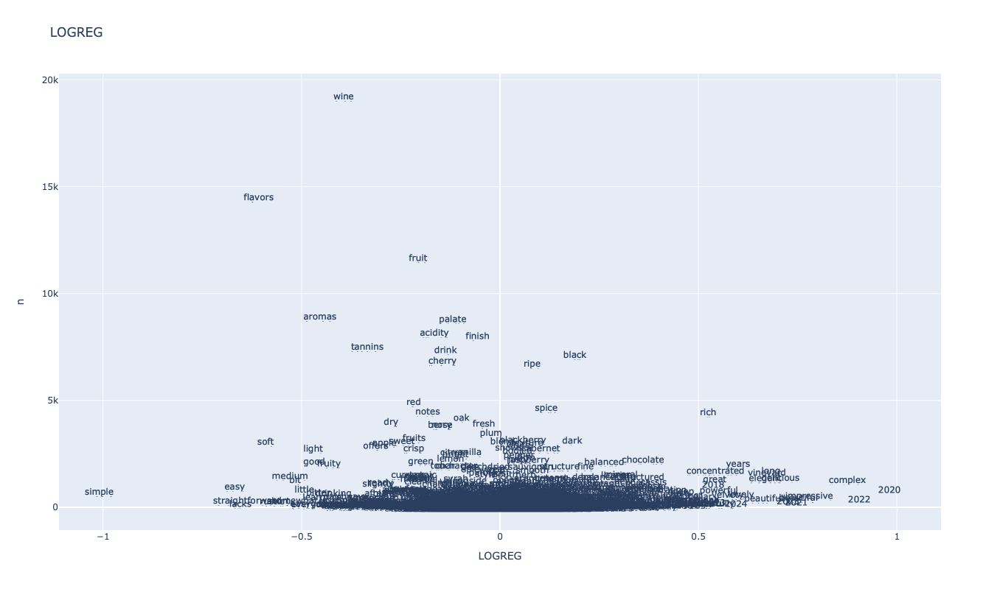

In [39]:
text('LOGREG')

## Mean

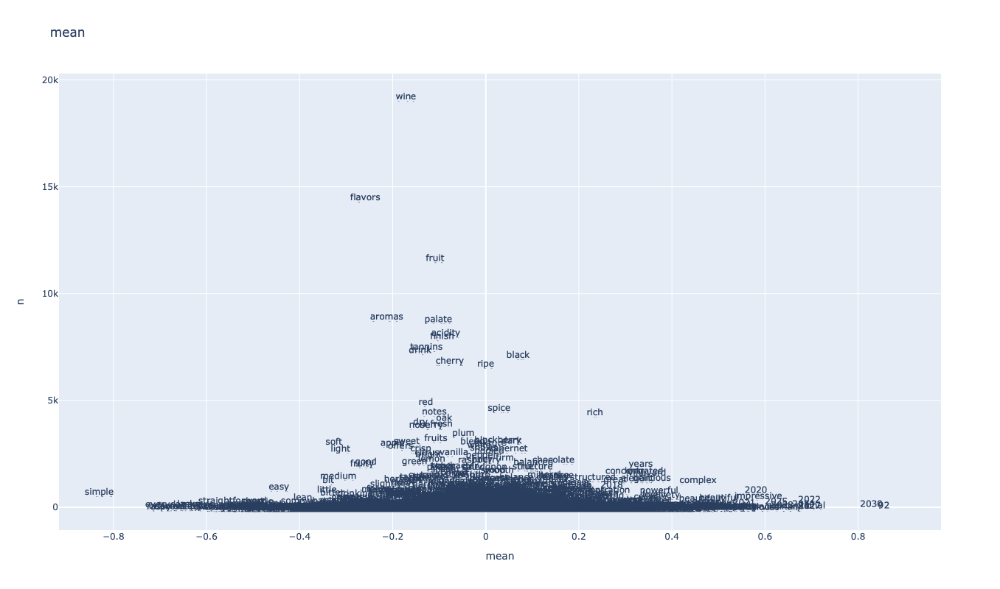

In [40]:
text('mean')

# Observations

- Logistic Regression is the best performer by F1, mean peformance score, performance score wins.
  - Home-grown Naive Bayes is a close second.
  - All perform in the same range excpet Expected Mutual Information (MI).
  - MI is the least balanced with high recall but low specificity and precision.
- The discriminant models are highly correlated to each other, as are the generative ones.
  - The discriminant models are lowly correlated with the generative ones.
  - The two classes of methods seem to produce in-group similar results.
- The generative models appear to produce more intelligible vocabularies.
  - The discriminant models produce some curious negative terms, e.g. 'stonecap', 'venerable', 'distinguish'

# Save

In [41]:
SALEX.columns.names = ['model_id', 'metric']

In [42]:
SALEX.T.to_csv(f"{data_home}/{data_prefix}/{data_prefix}-ALL_SALEX.csv", index=True)

In [43]:
RESULT.to_csv(f"{data_home}/{data_prefix}/{data_prefix}-ALL_RESULT.csv", index=True)